In [729]:
import librosa
import librosa.display
import IPython.display as ipd 
from IPython.display import display
import numpy as np
import pandas as pd
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import shutil
import os
import math
from copy import deepcopy
import time

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import minmax_scale, FunctionTransformer, StandardScaler
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.manifold import TSNE
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, plot_confusion_matrix, plot_roc_curve, log_loss

import skopt
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
from skopt.plots import plot_convergence

import umap

%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# Загрузка данных и формирование набора данных

В данной работе задача состояла в разработке классификатора мужских и женских голосов на базе `LibriTTS`.
Для выполнения задания был скачен файл `train-clean-100.tar.gz`, который содержал `53.78` часов речи `247` спикеров. 

В данной работе не использовались state-of-the-art технологии на основе CNN, RNN, Transformer... требующих больших наборов данных и GPU. Было решено показать адекватное решение при условии данных вычислительных мощностей с использованием различных моделей и подходов к оптимизации.

Для начала выявим спикеров из данного набора данных, далее создадим словарь, содержащий аудио-записи мужских и женских голосов, который в дальнейшем обернем в `DataFrame` для более удобной работы.

In [24]:
PATH = 'train-clean-100.tar/train-clean-100/LibriTTS/'

In [25]:
# Загрузка файла со спикерами
readers = pd.read_csv(os.path.join(PATH, 'speakers.tsv'), sep='\t')
readers.columns = ['GENDER', 'SUBSET_NAME', 'READER']
readers.head()

,GENDER,SUBSET_NAME,READER
14,F,train-clean-360,Kristin LeMoine
16,F,train-clean-360,Alys AtteWater
17,M,train-clean-360,Gord Mackenzie
19,F,train-clean-100,Kara Shallenberg
20,F,train-other-500,Gesine


In [26]:
# Фильтрация спикеров по необходимому набору данных
readers = readers[readers.SUBSET_NAME == 'train-clean-100']

In [62]:
readers.head()

,GENDER,SUBSET_NAME,READER
19,F,train-clean-100,Kara Shallenberg
26,M,train-clean-100,Denny Sayers
27,M,train-clean-100,Sean McKinley
32,F,train-clean-100,Betsie Bush
39,F,train-clean-100,Sherry Crowther


In [64]:
# Распределние id спикеров данного набора по полу
fmale_ids = readers[readers.GENDER == 'F'].index.tolist()
male_ids = readers[readers.GENDER == 'M'].index.tolist()

In [76]:
# Создание словаря, содержащий аудио-записи мужских и женских голосов
res = {'F': list(), 'M': list()}

# Реализация обхода по директориям
speakres_ids = os.path.join(PATH, 'train-clean-100')
for f in os.listdir(speakres_ids):
    chapters = os.path.join(speakres_ids, f)
    for chapter in os.listdir(chapters):
        speeches = os.path.join(chapters, chapter)
        for speech in os.listdir(speeches):
            if '.wav' in speech:
                ids = int(f)
                if ids in fmale_ids:
                    gndr = 'F'
                if ids in male_ids:
                    gndr = 'M'
                res[gndr].append(os.path.join(speeches, speech))
                    

In [77]:
# Выведем количество спикеров и количество аудио-записей 
len(readers), len(res['F'] + res['M'])

(251, 33236)

In [111]:
# В качестве проверки выведем аудио
arr, sr = librosa.load(res['F'][1])
display(ipd.Audio(arr, rate=sr))

In [95]:
# Создадим датасет, содержащий 'gender' и путь к аудио-записи
dataset = pd.DataFrame({'gender': ['F'] * len(res['F']) + ['M'] * len(res['M']),
                        'audio': res['F'] + res['M']})
shuffle(dataset).head()

,gender,audio
31474,M,train-clean-100.tar/train-clean-100/LibriTTS/t...
23042,M,train-clean-100.tar/train-clean-100/LibriTTS/t...
27392,M,train-clean-100.tar/train-clean-100/LibriTTS/t...
15846,F,train-clean-100.tar/train-clean-100/LibriTTS/t...
2866,F,train-clean-100.tar/train-clean-100/LibriTTS/t...


# Первичный анализ данных

In [233]:
# Выведем основную информацио о созданном наборе
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33236 entries, 0 to 33235
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   gender  33236 non-null  object
 1   audio   33236 non-null  object
dtypes: object(2)
memory usage: 519.4+ KB


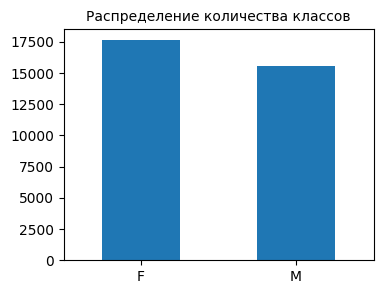

In [113]:
dataset.gender.value_counts().plot(kind='bar', rot=0, figsize=(4, 3));
plt.title('Распределение количества классов', fontsize=10);

*Из графика видно, что количество женских голосов в наборе данных немного больше. Но такая разница не критична и набор данных не будет иметь проблемы дис-баланса классов. Однако, разница все же будет учтена при обучении моделей*

***В качестве характеристик звукового сигнала, которые будут рассмотрены, выступают:***
- *Chroma Energy Normalized* (отображает рспределение энергии в кадре сигнала, подходит для сопоставления звука, где присутствуют вариации)
- *Мел-кепстральные коэффициенты* (описывают форму спектральной огибающей и моделируют общие и индивидуальные характеристики голоса. Также, данные коэффициенты позволяют идентифицировать периодические и резонансные структуры в частотном пространстве звукового сигнала)
- *Спектограмма* (отображает зависимость спектральной плотности мощности сигнала от времени)
- *Spectral Centroid* (расположение центра масс звука в каждом фрейме сигнала)
- *Spectral Rolloff* (мера формы сигнала)
- *Spectral Contrast* (разница между пиками и впадинами в спектре)

In [244]:
def plot_features(audio):
    '''Функция для отображения ...'''
    
    plt.rcParams.update({'font.size': 8})

    fig, axs = plt.subplots(2, 3, figsize=(15, 5), sharex=True)

    # загрузка аудио-записи
    signal, sr = librosa.load(audio)
    # разделение гармонических и ударных компонент сигнала
    harmonic, precussive = librosa.effects.hpss(signal)
    display(ipd.Audio(signal, rate=sr))

    ax = axs[1, 1]
    # рассчет Chroma Energy Normalized
    chroma = librosa.feature.chroma_cens(y=harmonic, sr=sr)
    sh = librosa.display.specshow(chroma, ax=ax, y_axis='chroma', x_axis='time')
    fig.colorbar(sh, ax=ax)
    ax.set_title('CENS')

    ax = axs[0, 1]
    # рассчет Мел-кепстральных коэффициентов
    mfccs = librosa.feature.mfcc(y=harmonic, sr=sr, n_mfcc=20)
    sh = librosa.display.specshow(mfccs, ax=ax, x_axis='time')
    fig.colorbar(sh, ax=ax)
    ax.set_title('MFCC')

    ax = axs[0, 2]
    # рассчет Спектограммы
    spec = librosa.stft(signal)
    spec = librosa.amplitude_to_db(abs(spec))
    sh = librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log', ax=ax)
    fig.colorbar(sh, ax=ax)
    ax.set_title('Spectrogram')


    ax = axs[1, 0]
    # рассчет Spectral Rolloff
    spectral_centroid = librosa.feature.spectral_centroid(signal, sr=sr)[0]
    times = librosa.frames_to_time(range(len(spectral_centroid)))
    librosa.display.waveshow(signal, sr=sr, alpha=.5, ax=ax, label='wive')
    ax.plot(times, minmax_scale(spectral_centroid), label='spectral centroid')
    ax.legend()
    ax.set_title('Spectral Centroid')

    ax = axs[0, 0]
    # рассчет Chroma Energy Normalized
    spectral_rolloff = librosa.feature.spectral_rolloff(signal + .01, sr=sr)[0]
    librosa.display.waveshow(precussive, sr=sr, alpha=.4, ax=ax, label='precussive')
    librosa.display.waveshow(harmonic, sr=sr, alpha=.4, ax=ax, label='harmonic')
    ax.plot(times, minmax_scale(spectral_rolloff), label='rolloff')
    ax.legend()
    ax.set_title('Spectral Rolloff')

    ax = axs[1, 2]
    # рассчет Spectral Contrast
    contrast = librosa.feature.spectral_contrast(harmonic, sr=sr)
    sh = librosa.display.specshow(contrast, x_axis='time', ax=ax)
    fig.colorbar(sh, ax=ax)
    ax.set_ylabel('Freq bands')
    ax.set_title('Spectral Contrast')

    plt.show();

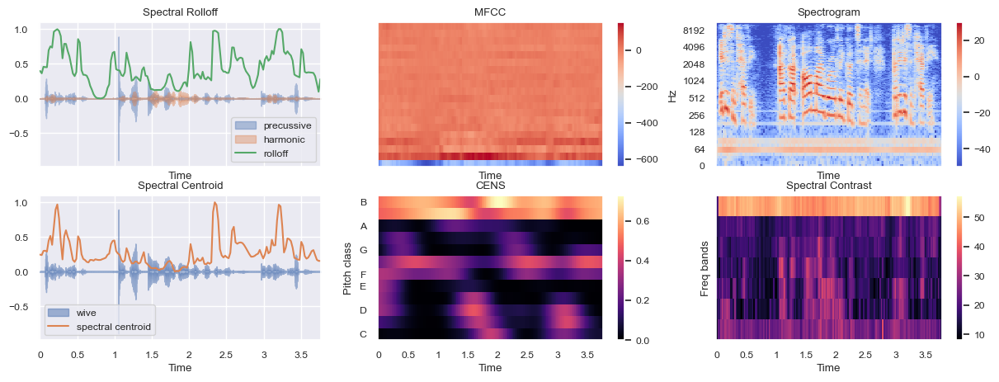

In [818]:
# Вывод характеристик женского голоса из базы
plot_features(dataset.audio[9])

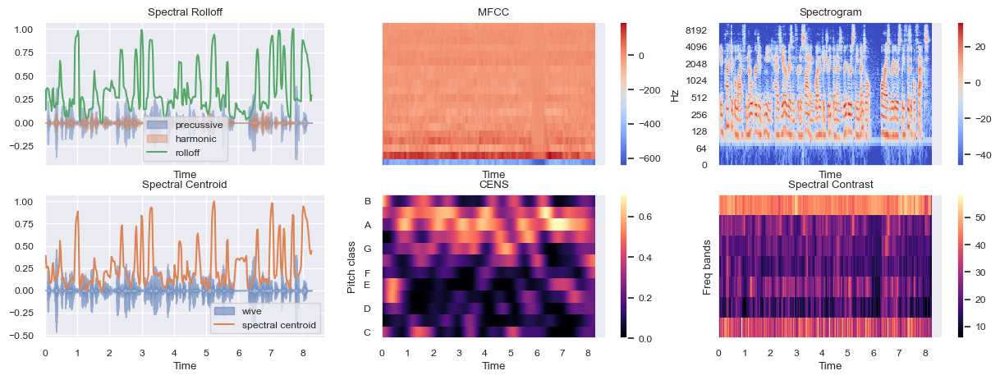

In [816]:
# Вывод характеристик мужского голоса из базы
plot_features(dataset.audio[len(dataset) - 40])

*Если рассмотреть спектограмму (или несколько), то можно увидеть, мужская речь сосредоточена на более низких частотах, чем женская (на низких частотах более размытая). Также появляется гипотеза, что, у одного из типов голосов должны быть более резкие переходы, однако из различных `MFCC` и `Spectral Centroid` графиков это не всегда явно прослеживается. Также в графиках `CENS` женских голосов задействованы более высокие ноты, а распределение мужского голоса на графике более резкое*

Для выделения признаков был создан класс `ExtractAudioFeatureStatisticsFromPandas`, наследующий свойства классов `BaseEstimator` и `TransformerMixin` из библиотки `sklearn`. Данный класс представляет собой интерфейс, реализующий преобразование исходного набора данных с аудио-записями в признаковое пространство для последующего анализа набора данных.

***В качестве сгенерированного признакого пространства, для примера, будут выступать следующие характеристики звукового сигнала:***
- Spectral Centroid
- Spectral Rolloff
- MFCC

***Для каждой характеристики будет вычислены:***
- среднее значение
- дисперсия
- скос распределения (степень несимметричности распределения относительно его среднего)

In [651]:
class ExtractAudioFeatureStatisticsFromPandas(BaseEstimator, TransformerMixin):
    
        def __init__(self, n_mfcc=5, audio_duration=5):
            '''
            Функция инициализации класса
            Поля:   
                n_mfcc: количество вычисляемых коэффициентов mfcc
                audio_duration: максимальная продолжительность аудио 
                statistics: рассчитываемые статистики
                features: словарь со начениями новых признаков
            '''

            self.n_mfcc=n_mfcc
            self.audio_duration = audio_duration

            self.statistics = {'mean': np.mean,
                               'std': np.std,
                               'skew': scipy.stats.skew}
            self.features = {}
            for statistic in self.statistics.keys():
                self.features[f'{statistic}_spectral_centroid'] = []
                self.features[f'{statistic}_spectral_rolloff'] = []
                for i in range(self.n_mfcc):
                    self.features[f'{statistic}_mfcc_{i}'] = []
    
    
        def fit(self, X, y=None):
            '''Обучение модели'''
            return self
    
        def transform(self, X, y=None):
            '''Преобразование входного набора данных'''
            
            new_features = deepcopy(self.features)

            for f in X.audio:
                
                # Вычисление признаков сигнала
                signal, sr = librosa.load(f, duration=self.audio_duration)
                mfccs = librosa.feature.mfcc(y=signal, sr=sr, n_mfcc=self.n_mfcc)
                sc = librosa.feature.spectral_centroid(y=signal, sr=sr)
                sr = librosa.feature.spectral_rolloff(y=signal, sr=sr)

                for name, statistic in self.statistics.items():

                    # Вычислить статистики
                    st = statistic(mfccs, axis=1)
                    for i, v in enumerate(st):
                            new_features[f'{name}_mfcc_{i}'].append(v)

                    new_features[f'{name}_spectral_centroid'].append(statistic(sc.T, axis=0)[0])

                    new_features[f'{name}_spectral_rolloff'].append(statistic(sr.T, axis=0)[0])

            return pd.concat([X, pd.DataFrame(new_features)], axis=1)


In [363]:
# Инициализация класса-преобразователя
audio_features = ExtractAudioFeatureStatisticsFromPandas(n_mfcc=10, audio_duration=5)
audio_features.fit(dataset);

In [364]:
%%time
# Преобразование исходного набора данных
audio_features = audio_features.transform(dataset).drop(['audio'], axis=1)

CPU times: total: 43min 51s
Wall time: 44min 29s


In [366]:
# Отобразить содержимое признакового пространства
audio_features.tail()

,gender,mean_spectral_centroid,mean_spectral_rolloff,mean_mfcc_0,mean_mfcc_1,mean_mfcc_2,mean_mfcc_3,mean_mfcc_4,mean_mfcc_5,mean_mfcc_6,...,skew_mfcc_0,skew_mfcc_1,skew_mfcc_2,skew_mfcc_3,skew_mfcc_4,skew_mfcc_5,skew_mfcc_6,skew_mfcc_7,skew_mfcc_8,skew_mfcc_9
33231,M,2162.173243,3964.402262,-382.232849,97.665436,-19.417919,30.076054,3.299934,-9.216380,-7.050289,...,-0.448939,-0.656187,-0.504867,0.618243,-0.569546,-0.373859,0.103585,-0.358009,-0.543100,-0.120438
33232,M,1901.344587,3355.659837,-341.496002,105.543282,-24.790995,29.314537,0.864379,-8.842326,-12.266315,...,-0.454703,-1.041716,-0.223305,0.351241,-0.308595,-0.356930,0.195636,-0.021454,0.048006,0.286499
33233,M,1685.663633,3076.463581,-373.752380,126.403465,-32.176567,52.933926,-3.153501,-24.655622,-13.318947,...,-0.132271,-1.263933,-0.478482,0.224540,0.227557,0.782118,-0.727175,0.253063,0.533594,-0.247903
33234,M,2293.069111,3971.829224,-342.705841,98.635162,-19.436943,20.830259,0.333013,1.303558,-14.782235,...,-0.745461,-0.667949,-0.040615,-0.157791,-0.361382,-0.208988,-0.331888,-0.653946,-0.334117,-0.055673
33235,M,2262.420986,3994.815467,-365.317810,100.042519,-15.826379,23.251839,-6.251653,-0.332678,-12.681933,...,-0.609440,-0.851508,-0.102909,0.049238,-0.627378,-0.152371,-0.422990,-0.242072,-1.347700,0.336807


In [367]:
# Сохранение набора
audio_features.to_csv('dataset.csv')

In [368]:
# Вывод размерности данных
audio_features.shape

(33236, 37)

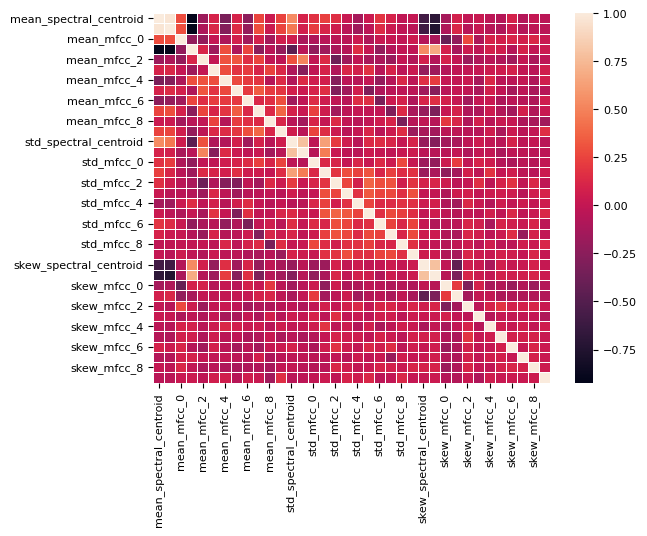

In [413]:
# Построение тепловой карты для занчений линейной корреляции Пирсона
sns.heatmap(audio_features.corr(), annot=False, fmt='.1f', linewidths=.5);

***Из графика выше видно, что в наборе данных содержатся высококоррелированные признаки. Известно, что мультиколлениарность явялется причиной переобучения линейных моделей, деградации случайного леса из-за метода выборки случайных подпространств признаков, а также является причиной увеличения сложности модели.***

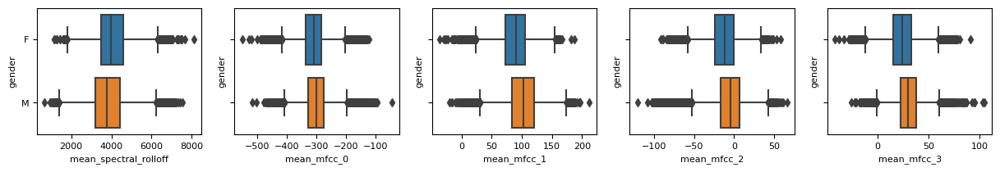

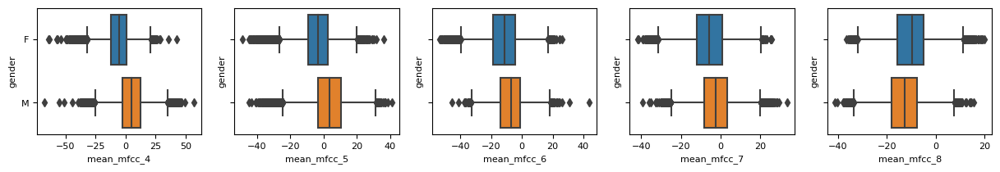

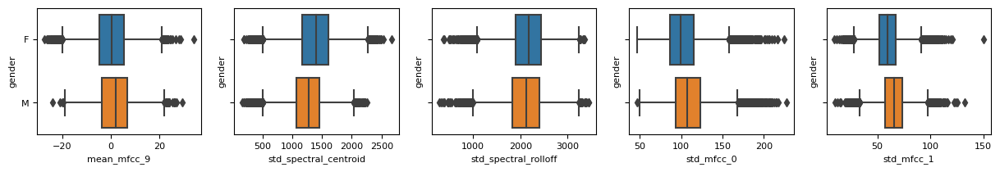

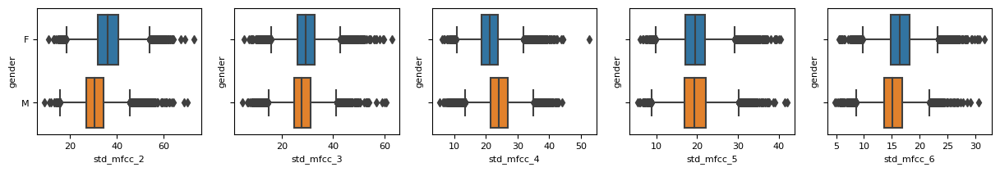

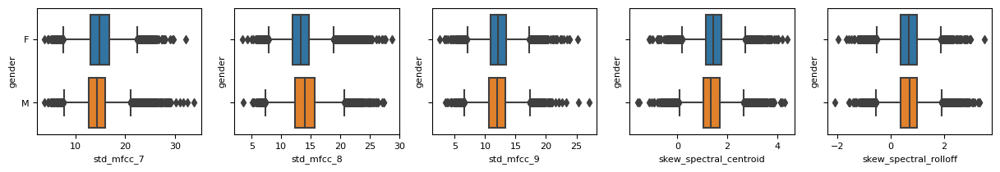

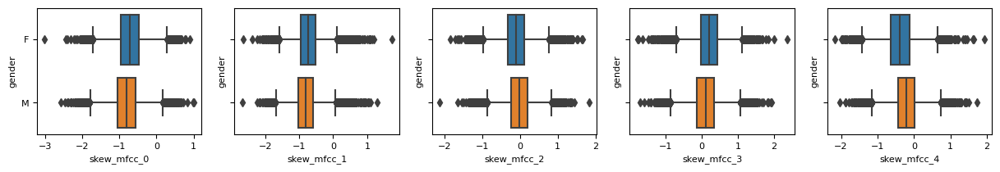

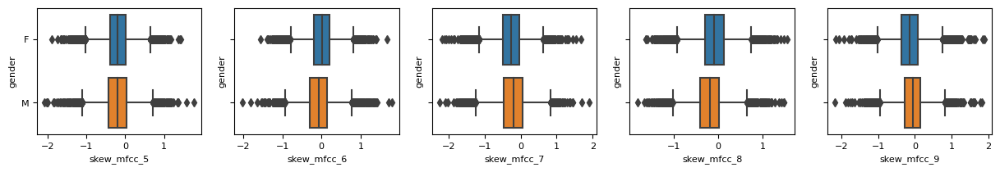

In [458]:
# Отрисовка диаграмм размаха для выявления различий распределения признаков для мужских и женских голосов 
def plot_boxplot(vals):
    _, ax = plt.subplots(1, 5, figsize=(15, 2), sharey=True)
    for i, col in enumerate(vals):
        sns.boxplot(data=audio_features, x=col, y='gender', ax=ax[i])
    return

columns = audio_features.columns.values[1:]
for i in range(1, len(columns), 5):
    plot_boxplot(columns[i:i+5])


**Из графиков выше можно увидеть *паттерн*: в основном, для распределения средних значений `mfcc` - медиана для мужских голосов больше, а для средних `spectral_rolloff` и дисперсии `spectral_centroid` - меньше.**

In [479]:
# Запись признакового пространства и меток в отедельные переменные
audio_features, gender = audio_features.drop(['gender'], axis=1), audio_features.gender

In [481]:
assert audio_features.shape[1] == 36

Далее необходимо провести **стандартизацию переменных** для устранения искаженного восприятия данных алгоритмами машинного обучения, так как признаки данного набора данных имеют различия между своими диапазонами. Также стандартизация не имеет ограничивающего диапазона и не подвержен влиянию выбросов.
Вычисляется станадратизация следующим образом:

<center>$z_i = \frac{x_i - \mu}{\sigma}$</center>

In [488]:
%%time
sc = StandardScaler().fit(audio_features)
# Вычисление низкоразмерных представлений с помощью UMAP и t-SNE
reduced_audio_feature_umap = umap.UMAP(n_components=3).fit_transform(sc.transform(audio_features))
reduced_audio_feature_tsne = TSNE(n_components=3).fit_transform(sc.transform(audio_features))

CPU times: total: 1h 1min 20s
Wall time: 5min 41s


Перед выполненим обучения визулизируем ***низкоразмерное*** представление признакового пространства, чтобы представить распределение целевой переменной. Для этого используется техника нелинейного снижения размерности `UMAP` (и `t-SNE`). Данный метод моделирует объект высокой размерности низкоразмерной точкой так, что похожие объекты оказываются ближе друг к другу, чем не похожие.

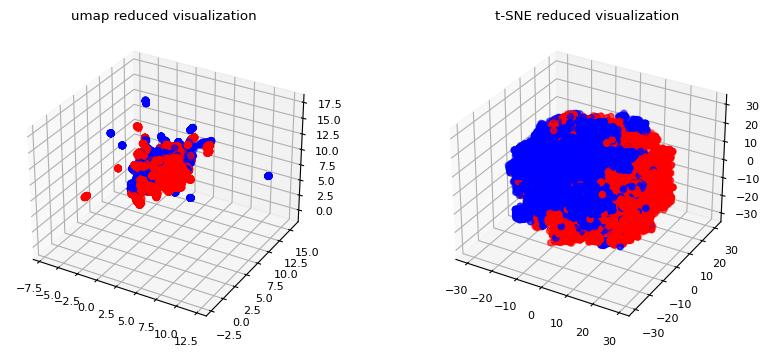

In [489]:
# Отрисовка 3-х компонент
fig = plt.figure(figsize=(10, 4))
ax = fig.add_subplot(1, 2, 1, projection='3d')
ax.scatter3D(reduced_audio_feature_umap[:, 0], reduced_audio_feature_umap[:, 1], 
             reduced_audio_feature_umap[:, 2], c=gender.map({'F':'b', 'M':'r'}))
ax.set_title('umap reduced visualization');
ax = fig.add_subplot(1, 2, 2, projection='3d')
ax.scatter3D(reduced_audio_feature_tsne[:, 0], reduced_audio_feature_tsne[:, 1], 
             reduced_audio_feature_tsne[:, 2], c=gender.map({'F':'b', 'M':'r'}))
ax.set_title('t-SNE reduced visualization');

In [493]:
%%time
sc = StandardScaler().fit(audio_features)
reduced_audio_feature_umap = umap.UMAP(n_components=2).fit_transform(sc.transform(audio_features))
reduced_audio_feature_tsne = TSNE(n_components=2).fit_transform(sc.transform(audio_features))

CPU times: total: 19min 59s
Wall time: 1min 57s


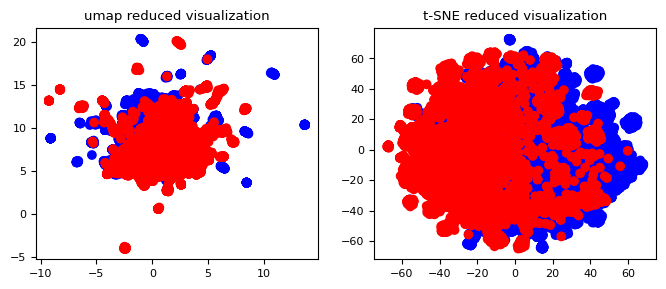

In [498]:
# Отрисовка 2-х компонент
fig = plt.figure(figsize=(8, 3))
ax = fig.add_subplot(1, 2, 1)
ax.scatter(reduced_audio_feature_umap[:, 0], reduced_audio_feature_umap[:, 1], c=gender.map({'F':'b', 'M':'r'}))
ax.set_title('umap reduced visualization');
ax = fig.add_subplot(1, 2, 2)
ax.scatter(reduced_audio_feature_tsne[:, 0], reduced_audio_feature_tsne[:, 1], c=gender.map({'F':'b', 'M':'r'}))
ax.set_title('t-SNE reduced visualization');

Анализируя полученные выше графики, в данном случае нельзя однозначно сказать, что классы являются линейно разделимыми в исходном пространстве признаков. 

# Обучение моделей

*Кросс-валидация пытается оценить обобщающую способность обученного алгоритма. Для этого используется отложенная выборка, которая не участвует в обучении. В данной работе использовалась сначала `Hold-Out Validation`, далее был выбран алгоритм, на котором была проведена `k-fold validation`, но уже на этапе оптимизации гиперпараметров.*

In [781]:
# Разделить набор данных на тренировочный и тестовый наборы
X_train, X_test, y_train, y_test = train_test_split(audio_features, gender, shuffle=True, test_size=.33, random_state=2022)

In [782]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

***Выбранные модели классификации:***
- *Логистическая регрессия* (быстрый и производительный алгоритм для построения линейных разделяющих поверхностей, является `baseline`-решением для задач)
- *Метод опроных векторов* (универсальный алгоритм, оптимизационная задача которой сводится к поиску разделяющей гиперплоскости с наибольшим зазором в неявном пространстве признаков высокой размерности без вычисления координат данных в пространстве, который может быть неустойчив к шуму)
- *Градиентный бустинг* (состоит из ансамбля слабых предсказывающих моделей, которыми в основном являются деревья решений, однако обладает большей обобщающей способностью, что является следствием `дилеммы смещения-дисперсии`)
- *Полносвязанная нейронная сеть* из `sklearn` (Нейронные сети обладают возможностью извлечения нейлинейных зависимостей в данных, что может лучше описать набор данных)

In [783]:
classify_models = [
    LogisticRegression(penalty='elasticnet',
                       C=.3,
                       class_weight='balanced',
                       solver='saga',
                       l1_ratio=.6, random_state=2022),
    SVC(C=.05,
        kernel='rbf',
        class_weight='balanced',
        random_state=2022), 
    GradientBoostingClassifier(n_estimators=50,
                               max_features='sqrt',
                               max_depth=2,
                               learning_rate=0.1, random_state=2022),
    MLPClassifier(hidden_layer_sizes=(50, 10),
                  activation='relu',
                  learning_rate='adaptive',
                  alpha=.1,
                  early_stopping=True,
                  max_iter=300,
                  solver='adam', random_state=2022)]

classify_names = [
    'LogisticRegression',
    'SVC',
    'GradientBoostingClassifier',
    'MLPClassifier']

fitted_models = []

In [784]:
%%time
for i, (m, n) in enumerate(zip(classify_models, classify_names)):
    model = m
    model.fit(X_train, y_train)
    fitted_models.append(model)
    print(f'{n} is fitted')

LogisticRegression is fitted
SVC is fitted
GradientBoostingClassifier is fitted
MLPClassifier is fitted
CPU times: total: 34.4 s
Wall time: 29.6 s


*Данные алгоритмы запускались несколько раз, параллельно вполнялся ручной подбор гиперпараметров (точнее, установка регуляризаторов), так как было выявлено, что на данном датасете модели с установленными по умолчанию гиперпараметрами достаточно сильно переобучаются (например: точность на трейне - 0.99, а на тесте: 0.95)*

# Рассчет метрик

*Для расчета качетсва классификации были вычислены следующие метрики классификации:*
- accuracy
- precision
- recall
- f1-score
- AUC-score
- отрисована для наглядности confusion matrix

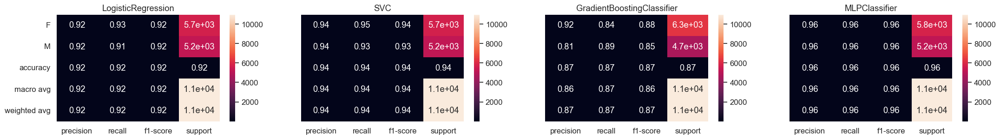

In [785]:
sns.set(font_scale=1.1)

def classification_report_plot(X_test, y_test):
    _, ax = plt.subplots(1, len(fitted_models), figsize=(26, 3), sharey=True)
    for i, (m, n) in enumerate(zip(classify_models, classify_names)):
        sns.heatmap(pd.DataFrame(classification_report(m.predict(X_test), y_test, output_dict=True)).T,
                        annot=True, ax=ax[i])
        ax[i].set_title(f'{n}')
    return 

# Вычисление стандартных метрик качества классификации на тестовом наборе
classification_report_plot(X_test, y_test)

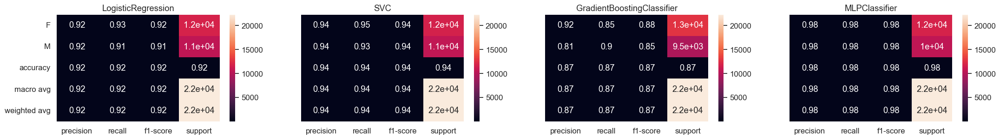

In [786]:
# Вычисление стандартных метрик качества классификации на тренировочном наборе
classification_report_plot(X_train, y_train)

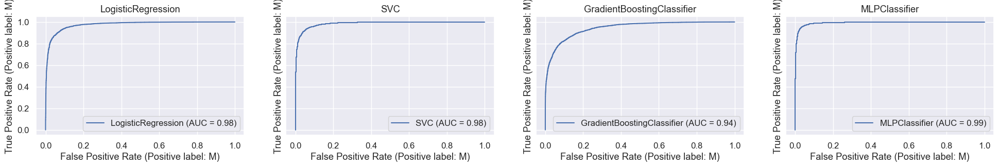

In [787]:
# Вычисление ROC-AUC на тестовом наборе
_, ax = plt.subplots(1, len(fitted_models), figsize=(24, 3), sharey=True)
for i, (m, n) in enumerate(zip(classify_models, classify_names)):
    plot_roc_curve(m, X_test, y_test, ax=ax[i])
    ax[i].set_title(f'{n}')

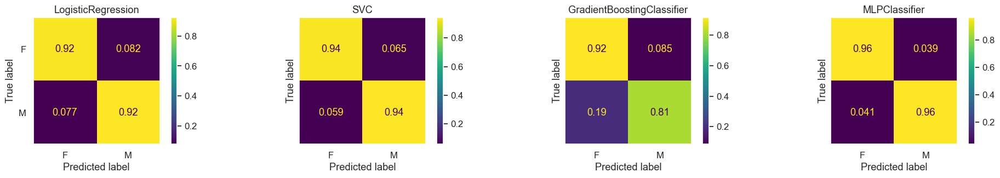

In [788]:
# Вычисление confusion matrix на тестовом наборе
_, ax = plt.subplots(1, len(fitted_models), figsize=(24, 3), sharey=True)
for i, (m, n) in enumerate(zip(classify_models, classify_names)):
    plot_confusion_matrix(m, X_test, y_test, ax=ax[i], normalize='true')
    ax[i].set_title(f'{n}')
    ax[i].grid(False)

*Сначала были рассчитаны метрики `accuracy`, `precision`, `recall`, `f1-score` для тестовых и тренировочных наборах, для определения переобучения, далее вычислены `AUC-score` и `confusion matrix` только для тестовых. Результаты представлен выше на рисунках. Значения метрик разнятся, поэтому выбор алгоритма зависист от бизнес-задачи, однако наиболее высокие значения метрик получили `MLPClassifier` и `SVC`.*

# Тестирование

*Для тестирования модели были использованы несколько аудио-записей из набора `dev-clean.tar`, а также несколько скаченных аудиозаписей:*
- речь Ленина
- речь Молотова
- женский голос, жалающий счастливого Нового Года
- крики Марии Шараповой во время игры в теннис

In [740]:
sns.set(font_scale=0.8)

In [741]:
# Загрузка тестовых данных
test = pd.DataFrame({'audio': ['test/lenin-obraschenie.wav', 
                        'test/krikov-marii-sharapovoy.wav', 
                        'test/jenskiy-golos.wav', 
                        'test/rech-molotov-26477.wav',
                        'test/test1_M.wav',
                        'test/test2_M.wav',
                        'test/test3_F.wav',
                        'test/test4_F.wav']})

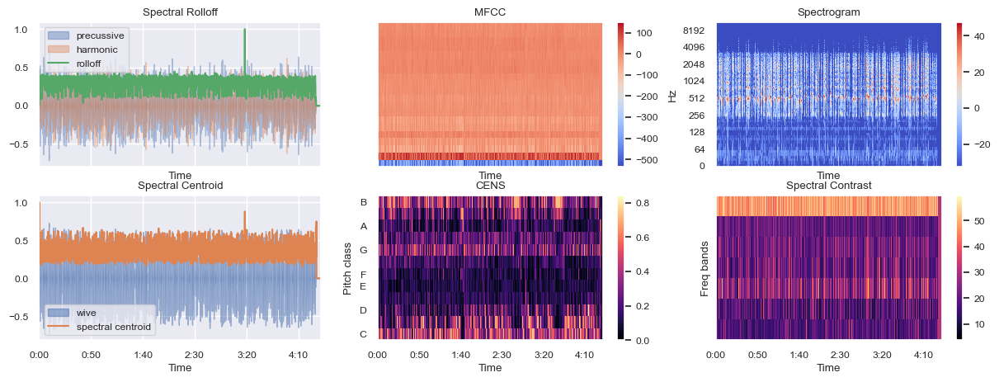

In [704]:
# Ленин
plot_features(test.audio[0])

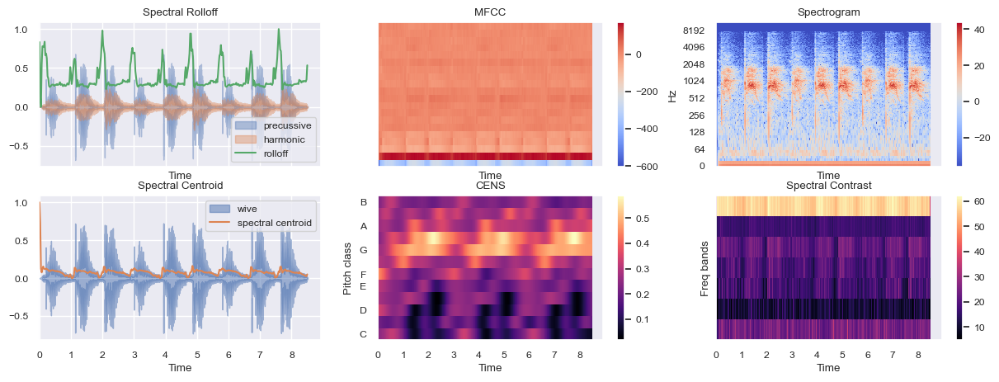

In [705]:
# Крики Марии Шараповой во время игры в теннис
plot_features(test.audio[1])

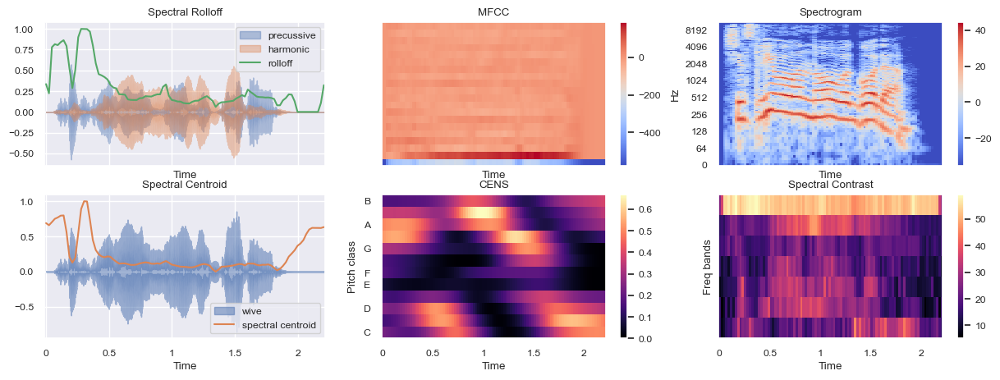

In [706]:
# Женский голос желает счастливого нового года
plot_features(test.audio[2])

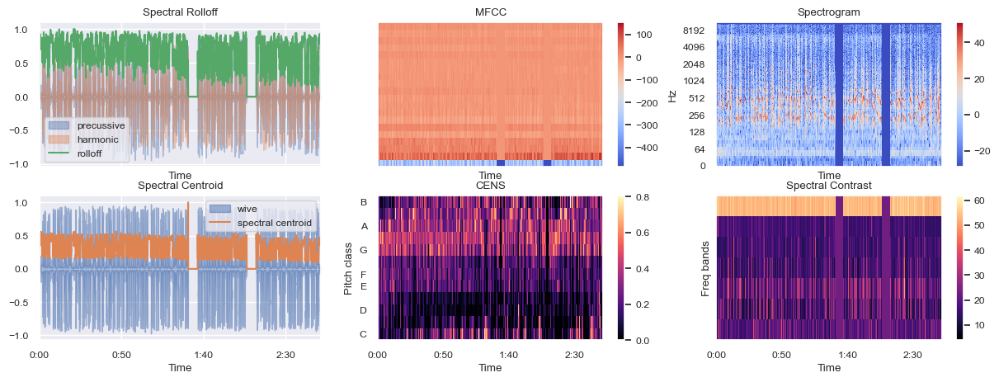

In [707]:
# Речь молотого 
plot_features(test.audio[3])

In [742]:
# Преобразование данных
transformer = ExtractAudioFeatureStatisticsFromPandas(n_mfcc=10, audio_duration=5)

In [743]:
predict_input = transformer.transform(test).drop(['audio'], axis=1)

In [744]:
test.index = ['Ленин', 'Шарапова', 'Женский голос', 'Молотов', 'M1', 'M2', 'F1', 'F2']

In [780]:
# Выполнение предсказаний
for m, n in zip(fitted_models, classify_names):
    test[f'{n}_predict'] = m.predict(predict_input)

test

,audio,LogisticRegression_predict,SVC_predict,GradientBoostingClassifier_predict,MLPClassifier_predict
Ленин,test/lenin-obraschenie.wav,M,M,M,M
Шарапова,test/krikov-marii-sharapovoy.wav,M,M,F,M
Женский голос,test/jenskiy-golos.wav,M,M,F,M
Молотов,test/rech-molotov-26477.wav,M,M,F,M
M1,test/test1_M.wav,M,M,F,M
M2,test/test2_M.wav,M,M,M,M
F1,test/test3_F.wav,M,M,M,M
F2,test/test4_F.wav,M,M,F,M


*Из таблицы выше видно, что ни одна модель не предсказала все правильные метки полностью. (На самом деле, изначально только на одном ошибалась MLPClassifier, однако предсказания изменились после побдора гиперпараметров)*

*Скорее всего модели переобучены на наборе данных `train-clean-100.tar.gz` из-за самой природы данного датасета (высокое качество записи), а также высокого шума в представленых на тест аудио-записях. Для получения более высоких результатов необходима аугментация тренировочного набора*.

# Валидация и оптимизация гиперпараметров

***Для выполнения валидации использовался MLPClassifier, так как нейронная сеть (даже такая простенькая) является достаточно гибкой архитектурой, позволяющей выявлять скрытые представления данных. Было решено подобрать `максимальное количество итераций`, `количество скрытых слоев`, `количество нейронов в скрытом слое` с помощью байесовской оптимизации, реализованной в Scikit-Optimize.***

Байесовская оптимизация представляет из себя итерационный метод, который позволяет оценить оптимум функции, не дифференцируя её, а на каждой итерации метод указывает, в какой следующей точке с наибольшей вероятностью изменяется оценка оптимума. Это позволяет значительно сократить количество вычислений функции.
Для выполнения оптимизации был реализован класс `MLPClassifierOptimizer`.

In [712]:
X_train, X_test, y_train, y_test = train_test_split(audio_features, gender, shuffle=True, test_size=.33, random_state=2022)

In [713]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [753]:
class MLPClassifierOptimizer:
    best_score = None
    classify_gp = None
    
    def __init__(self, model, X_train, y_train, n_fold=5):
        '''
        Инициализация класса
        Поля:
            model: модель ML
            X_train: пространство признаков
            y_train: метки класса
            n_fold: количество фолдов валидации
        '''
        self.model = model
        self.X_train = X_train
        self.y_train = y_train
        self.n_fold = n_fold
    
    def update_model(self, **kwords):
        '''Установка параметров модели'''
        for k, v in kwords.items():
            setattr(self.model, k, v)
    
    def evaluate_model(self):
        '''Вычисление ошибки модели'''
        scores = cross_val_score(self.model, self.X_train, self.y_train, scoring='neg_log_loss', cv=self.n_fold)
        return -np.mean(scores)
    
    def optimize(self, space, max_evals=20, n_random_starts=5):
        '''Функция подбора гиперпараметров модели: hidden_layer_sizes, max_iter'''
        
        @use_named_args(space)
        def objective(**params):
            params['hidden_layer_sizes'] = (params['hidden_size'], ) * params['hidden_layers']
            params.pop('hidden_size')
            params.pop('hidden_layers')
            self.model.set_params(**params)
            return self.evaluate_model()
        
        classify_gp = gp_minimize(objective, space, n_calls=max_evals, verbose=False,
                          n_random_starts=n_random_starts, random_state=2022, n_jobs=-1)
        
        self.best_score = classify_gp.fun
        self.classify_gp = classify_gp
        optimal_values = dict(zip([param.name for param in space], classify_gp.x))
        
        print(f'best score: {self.best_score}\noptima values: {optimal_values}')
        
        self.update_model(**optimal_values)
        # Отрисовка зависимости минимума функции потерь от шага 
        plot_convergence(self.classify_gp)
        return


In [754]:
# Реализация байесовской оптимизации
MLP = MLPClassifier(hidden_layer_sizes=(100, 50), activation='relu', learning_rate='adaptive',
                  early_stopping=True, max_iter=300, solver='adam', random_state=2022)

optimizer = MLPClassifierOptimizer(MLP, X_train, y_train)
space = [Integer(100, 500, name='max_iter'), Integer(1, 4, name='hidden_layers'), Integer(50, 1_000, name='hidden_size')]

best score: 0.11685423747201107
optima values: {'max_iter': 116, 'hidden_layers': 1, 'hidden_size': 571}
CPU times: total: 3h 35min 15s
Wall time: 1h 11min 2s


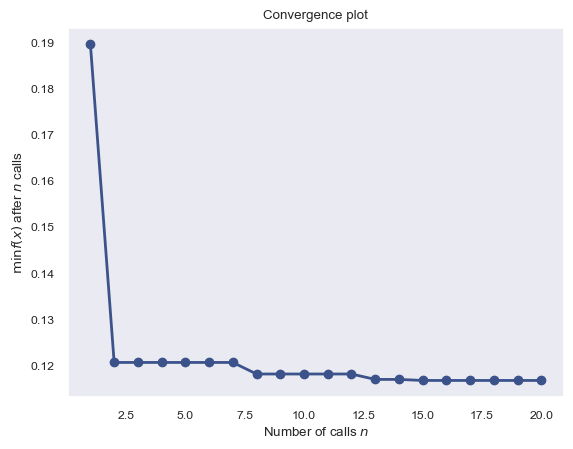

In [755]:
%%time
optimizer.optimize(space)

In [791]:
MLP = MLPClassifier(hidden_layer_sizes=(571,), activation='relu', learning_rate='adaptive',
                  early_stopping=True, max_iter=116, solver='adam', random_state=2022, alpha=1.5)
MLP.fit(X_train, y_train)

MLPClassifier(alpha=1.5, early_stopping=True, hidden_layer_sizes=(571,),
              learning_rate='adaptive', max_iter=116, random_state=2022)

Вычисление метрик классификации:

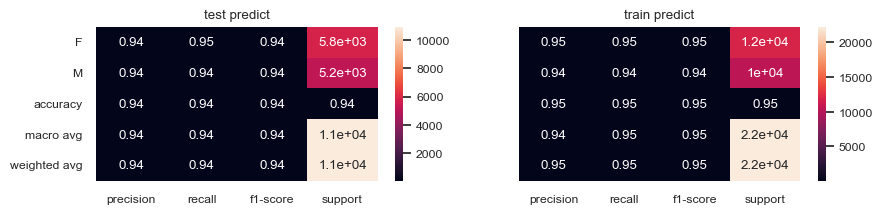

In [798]:
sns.set(font_scale=0.8)
_, ax = plt.subplots(1, 2, figsize=(10, 2), sharey=True)
sns.heatmap(pd.DataFrame(classification_report(MLP.predict(X_test), y_test, output_dict=True)).T,
                        annot=True, ax=ax[0])
ax[0].set_title(f'test predict')
sns.heatmap(pd.DataFrame(classification_report(MLP.predict(X_train), y_train, output_dict=True)).T,
                        annot=True, ax=ax[1])
ax[1].set_title(f'train predict');

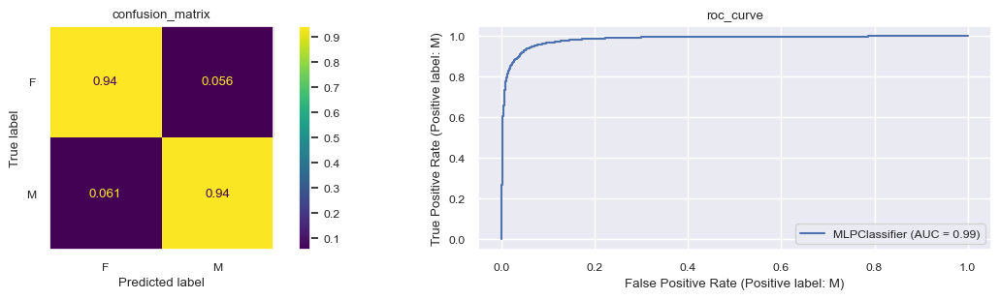

In [804]:
_, ax = plt.subplots(1, 2, figsize=(15, 3))
plot_confusion_matrix(MLP, X_test, y_test, ax=ax[0], normalize='true')
ax[0].set_title(f'confusion_matrix')
ax[0].grid(False)
plot_roc_curve(MLP, X_test, y_test, ax=ax[1])
ax[1].set_title(f'roc_curve');

В данном случае модель все-таки оказалась не переобученной, однако все же оптимизация не привела к повышению производительности классификации.

 # Возможности улучшения решения

***Дополнительно хотелось бы рассмотреть и другие алгоритмы решения данной задачи:***
- *Использование Гаусовских смесей для моделирования распределний каждого из классов (не уверен что сработает, не успел проверить)*
- *Использование больших наборов данных и более продвинутых фреймворков DL (PyTorch и TensorFlow), более полно раскрывающих потенциал нейронных сетей (например, в MLPClassifier используется только l2-параметр регуляризации, а Dropout-слой отсутствует), а также использующих различные архитектуры, наподобие CNN, RNN..*
- *Следует отметить, что `длина максимально загружаемого аудио-файла`, `количество мелл-спектральных харакеристик`, `виды статистик` в `ExtractAudioFeatureStatisticsFromPandas` также являются своего рода гиперпарматерами, которые следует устанавливать наиболее подходящим образом*
- *Помимо уже использованных характеристик звукового файла, можно добавить в набор данных `Спектограмму` и `Chroma Energy Normalized`, которые по своей природе должны хорошо учитывать различие в голосах*
- *Выполнить аугментацию*